In [3]:
import pandas as pd
import numpy as np


In [4]:
review_rating_df = pd.read_csv("https://raw.githubusercontent.com/be-prado/csci4521/refs/heads/main/goodreads_reviews_5pc.csv")
review_rating_df.shape

(23212, 3)

In [5]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
import numpy as np
import os


In [61]:
# %pip install nltk
# %pip install scikit-learn
# %pip install wordcloud

In [6]:
import nltk.stem
english_stemmer = nltk.stem.SnowballStemmer('english')

In [7]:
class StemmedTfidfVectorizer(TfidfVectorizer): #Applies stemming to vectorization "running" -> "run"
  def build_analyzer(self):
    analyzer = super(StemmedTfidfVectorizer, self).build_analyzer()
    return lambda doc: (english_stemmer.stem(w) for w in analyzer(doc))

In [6]:
vectorizer = StemmedTfidfVectorizer(min_df=1, stop_words='english') # All words are included (even rare words) and stop words are removed


In [7]:
X_train = vectorizer.fit_transform(review_rating_df['review_text']) # vectorizer transforms review_text column into a TF-IDF matrix (sparse), each row is a review, column is stemmed term

vectorizer.get_feature_names_out() # retrieve list of stemmed TF-IDF feature names

array(['00', '000', '000x', ..., 'zzz', 'zzzthat', 'zzzzzzz'],
      shape=(31810,), dtype=object)

In [8]:
num_clusters = 2
km = KMeans(n_clusters = num_clusters, init = 'random', n_init = 10, verbose = 1) 
# random centroid placement, could use k-means++ for better convergence, 
# runs algo 10 times with different centroid seeds, picks best result (lowest inertia)
# verbose prints progress during fitting
# X_train
km.fit(X_train)

c:\Users\brock\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py:131: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\brock\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py", line 247, in _count_physical_cores
    cpu_count_physical = _count_physical_cores_win32()
  File "c:\Users\brock\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py", line 299, in _count_physical_cores_win32
    cpu_info = subprocess.run(
        "wmic CPU Get NumberOfCores /Format:csv".split(),
        capture_output=True,
        text=True,
    )
  File "c:\Users\brock\AppData\Local\Programs\Python\Pytho

Initialization complete
Iteration 0, inertia 44430.691066216204.
Iteration 1, inertia 22673.24499370343.
Iteration 2, inertia 22650.022681083672.
Iteration 3, inertia 22636.356388566062.
Iteration 4, inertia 22629.568630504207.
Iteration 5, inertia 22626.976508339903.
Iteration 6, inertia 22626.112621866054.
Iteration 7, inertia 22625.759893240134.
Iteration 8, inertia 22625.5786180317.
Iteration 9, inertia 22625.46235983201.
Iteration 10, inertia 22625.383529022147.
Iteration 11, inertia 22625.315895603977.
Iteration 12, inertia 22625.264222871116.
Iteration 13, inertia 22625.230873225384.
Iteration 14, inertia 22625.207615087562.
Iteration 15, inertia 22625.18954000303.
Iteration 16, inertia 22625.171313020997.
Iteration 17, inertia 22625.151203898364.
Iteration 18, inertia 22625.129829229394.
Iteration 19, inertia 22625.110276235035.
Iteration 20, inertia 22625.09530069835.
Iteration 21, inertia 22625.083675484144.
Iteration 22, inertia 22625.073063177315.
Iteration 23, inertia 2262

,n_clusters,2
,init,'random'
,n_init,10
,max_iter,300
,tol,0.0001
,verbose,1
,random_state,None
,copy_x,True
,algorithm,'lloyd'


In [9]:
print(km.labels_[:10]) #The labels, where each review was assigned to cluster
# km.labels_.cluster_centers_.shape 
# km.cluster_centers_ #The actual cluster centers

[0 0 0 0 0 0 0 0 0 0]


In [10]:
review_rating_df['label'] = (review_rating_df['rating'] >= 2.5).astype(int) # Make each label binary of rating threshold


In [11]:
review_rating_df['cluster'] = km.predict(X_train) 

In [12]:
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score


In [13]:
y_true = review_rating_df['label']
y_pred = review_rating_df['cluster']

In [14]:
print("Accuracy:", accuracy_score(y_true, y_pred))
print("Precision:", precision_score(y_true, y_pred))
print("Recall:", recall_score(y_true, y_pred))
print("F1 Score:", f1_score(y_true, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_true, y_pred))
# confusion matrix: 
# [[TN, FP]
# [FN, TP]]

Accuracy: 0.19016026193348268
Precision: 0.9636462289744981
Recall: 0.08660457404788609
F1 Score: 0.15892617449664428
Confusion Matrix:
 [[ 2638    67]
 [18731  1776]]


I tokenized and vectorized for TF-IDF and with stemming. To determine how well the clusters capture whether a rating is above or below a 2.5 rating, I fit a kmeans model to the review_text data, which splits the data into two clusters of 1 and 0 (>= 2.5 or below 2.5). I then found the accuracy, precision, recall, and f1 scores.
Accuracy is 19%, which is worse than randomly guessing
Precision is 96%, when the model predicts 'Positive', it is often right
Recall is 08%, the model misses a lot of 'Positive' reviews
F1 is 15%, in general the model is poor at predicting a 'Positive' or 'Negative' rating for a given review

In [15]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [16]:
review_rating_df.shape

(23212, 5)

In [17]:
reviews = np.array(review_rating_df['review_text'])

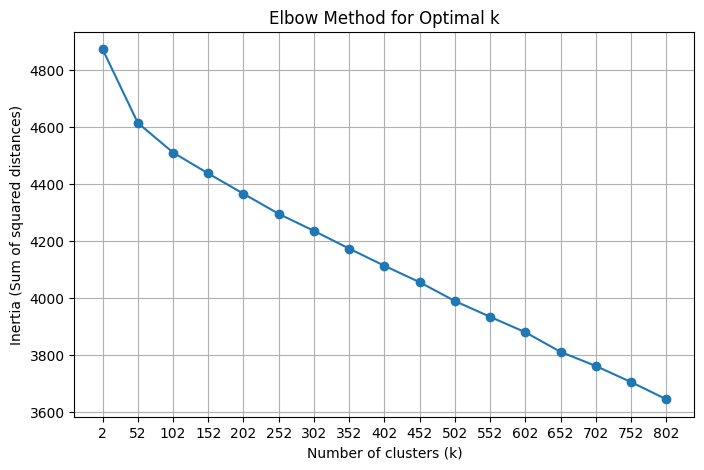

In [ ]:
sample_size = 5000
sample_indices = np.random.choice(X_train.shape[0], size=sample_size, replace=False)
X_sample = X_train[sample_indices]

cluster_range = list(range(2, 803, 50))
inertias = []

for k in cluster_range:
    km = KMeans(n_clusters=k, init='random', n_init=10, random_state=42)
    km.fit(X_sample)
    inertias.append(km.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertias, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia (Sum of squared distances)')
plt.xticks(cluster_range)
plt.grid(True)
plt.show()


In [18]:
# From the elbow method, 102 is a good number of clusters
num_clusters = 102
km = KMeans(n_clusters = num_clusters, init = 'random', n_init = 10, verbose = 1)
km.fit(X_train)

Initialization complete
Iteration 0, inertia 39612.62515560794.
Iteration 1, inertia 21754.98339179617.
Iteration 2, inertia 21443.346839405447.
Iteration 3, inertia 21270.706040586992.
Iteration 4, inertia 21179.38303484196.
Iteration 5, inertia 21128.38377611117.
Iteration 6, inertia 21105.791046406892.
Iteration 7, inertia 21098.377750306197.
Iteration 8, inertia 21093.93728981274.
Iteration 9, inertia 21090.718513868625.
Iteration 10, inertia 21087.978934001752.
Iteration 11, inertia 21085.447630596816.
Iteration 12, inertia 21083.712643012073.
Iteration 13, inertia 21082.022964124848.
Iteration 14, inertia 21079.904628890105.
Iteration 15, inertia 21078.723015992815.
Iteration 16, inertia 21078.37851233869.
Iteration 17, inertia 21078.050063571907.
Iteration 18, inertia 21077.788606904745.
Iteration 19, inertia 21077.495062653245.
Iteration 20, inertia 21077.150336017898.
Iteration 21, inertia 21076.79393668561.
Iteration 22, inertia 21076.162704625764.
Iteration 23, inertia 21075

,n_clusters,102
,init,'random'
,n_init,10
,max_iter,300
,tol,0.0001
,verbose,1
,random_state,None
,copy_x,True
,algorithm,'lloyd'


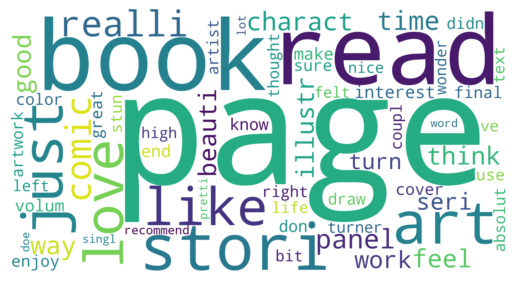

cluster size:  256


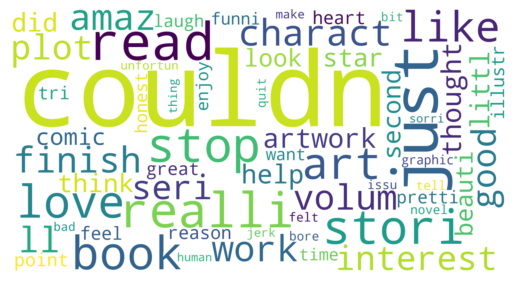

cluster size:  108


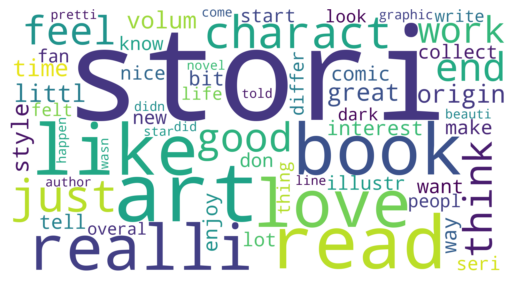

cluster size:  832


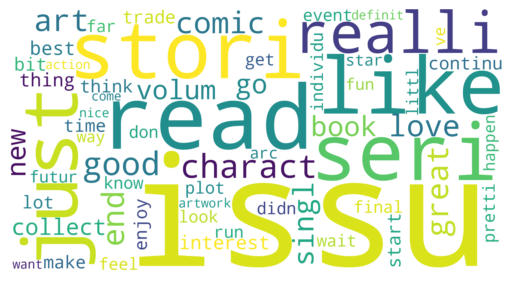

cluster size:  404


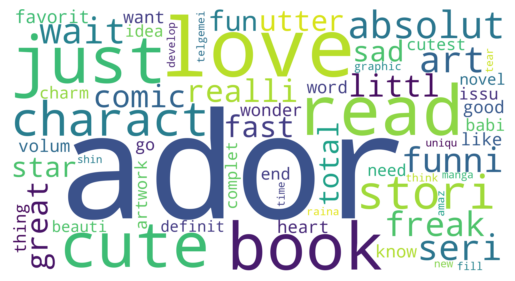

cluster size:  121


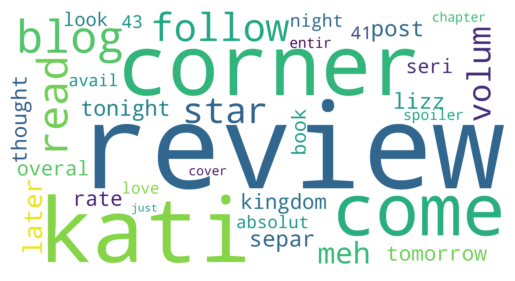

cluster size:  86


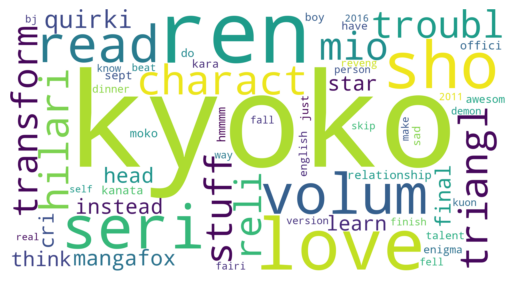

cluster size:  17


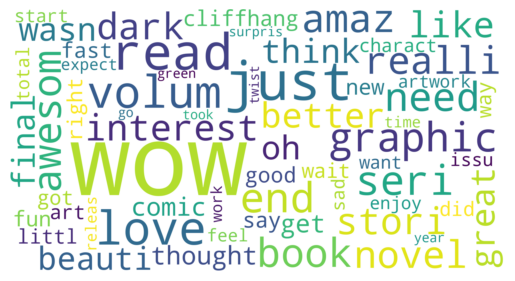

cluster size:  105


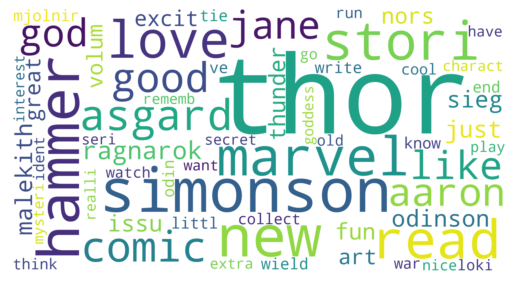

cluster size:  46


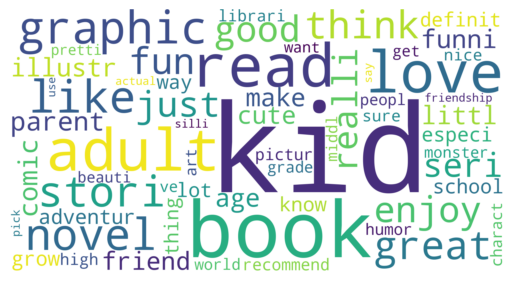

cluster size:  225


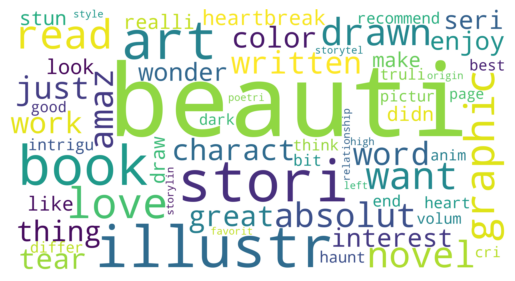

cluster size:  205


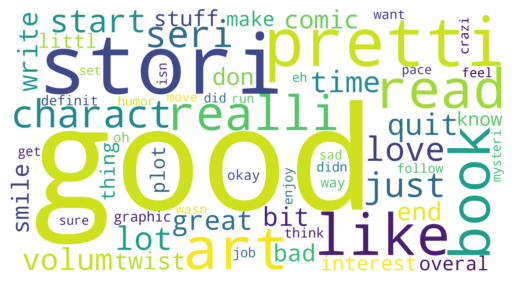

cluster size:  299


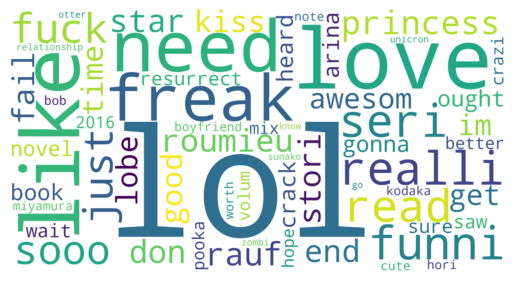

cluster size:  41


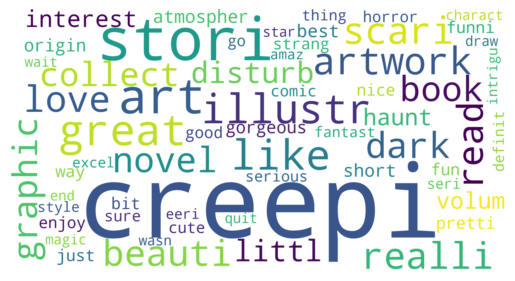

cluster size:  108


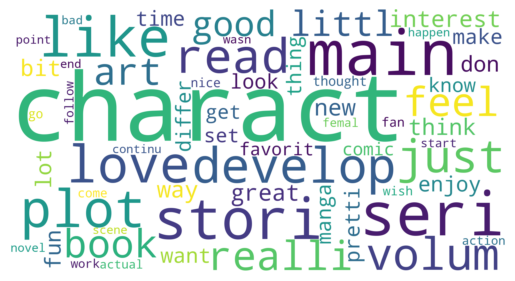

cluster size:  532


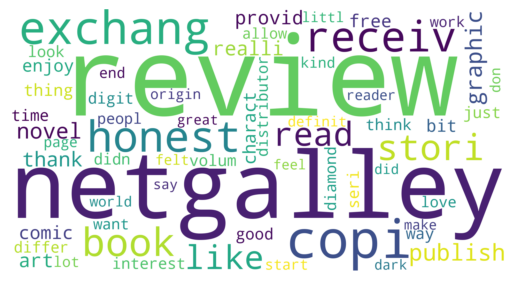

cluster size:  208


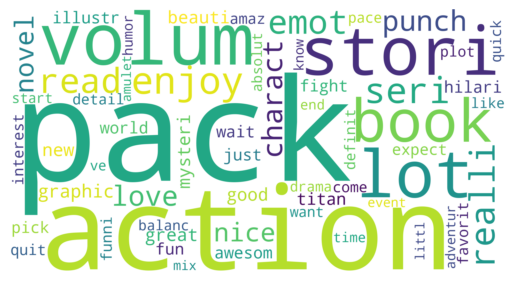

cluster size:  93


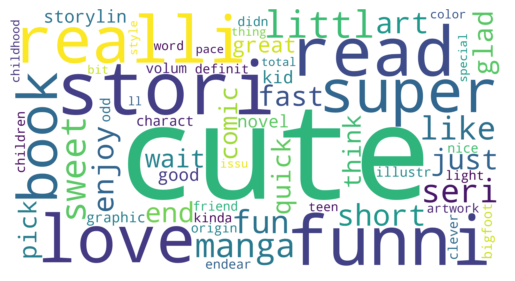

cluster size:  182


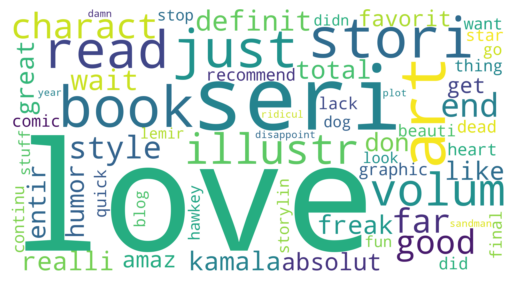

cluster size:  230


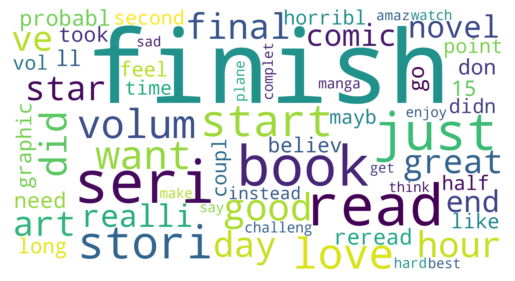

cluster size:  130


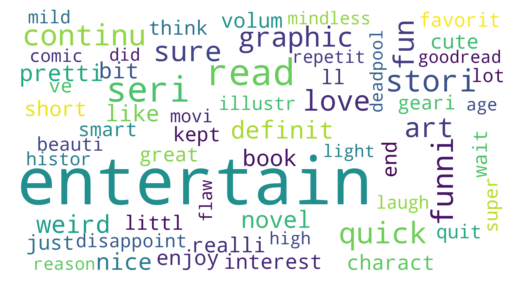

cluster size:  87


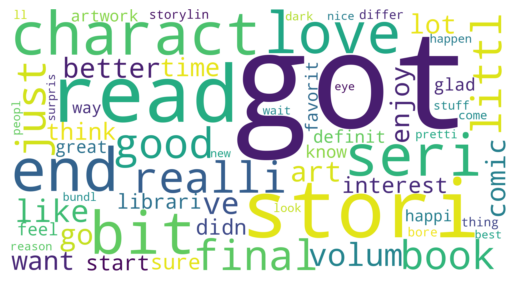

cluster size:  212


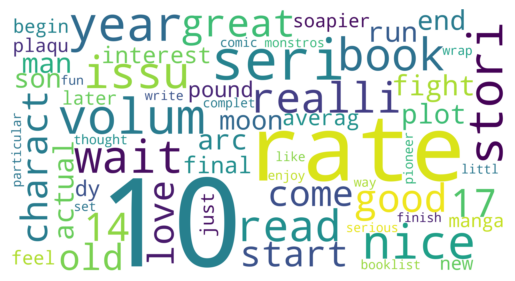

cluster size:  60


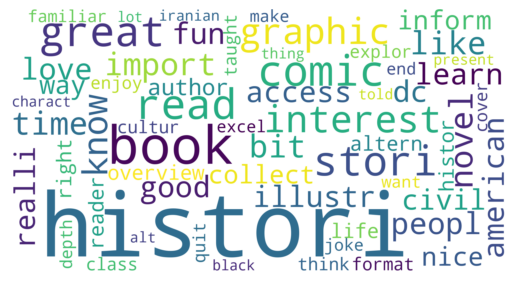

cluster size:  116


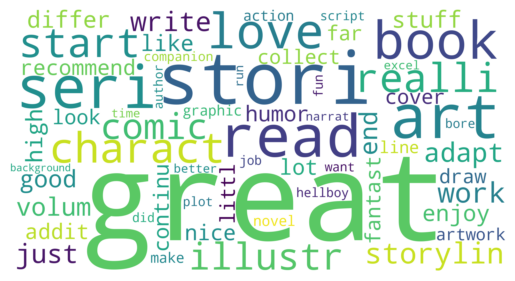

cluster size:  235


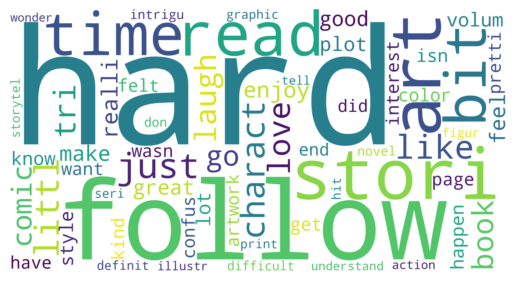

cluster size:  159


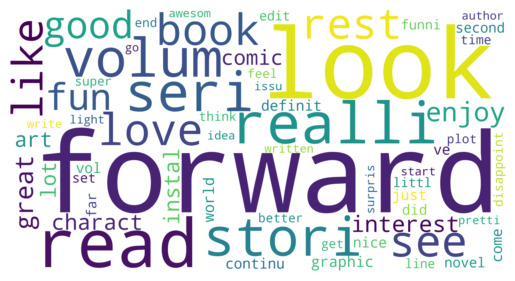

cluster size:  186


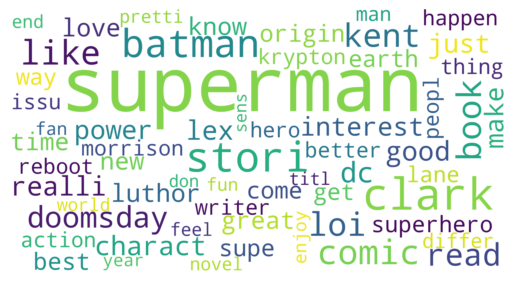

cluster size:  144


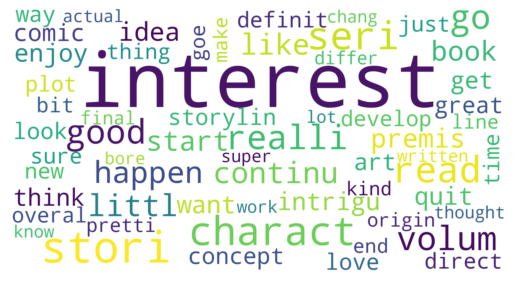

cluster size:  255


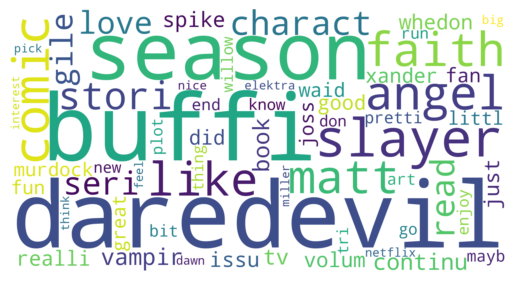

cluster size:  103


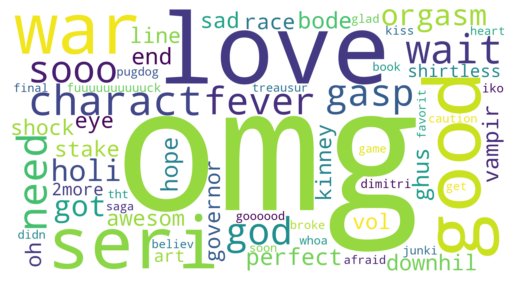

cluster size:  32


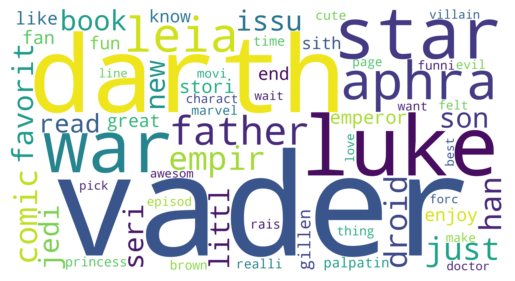

cluster size:  52


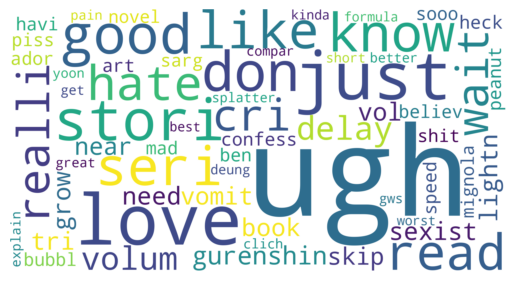

cluster size:  34


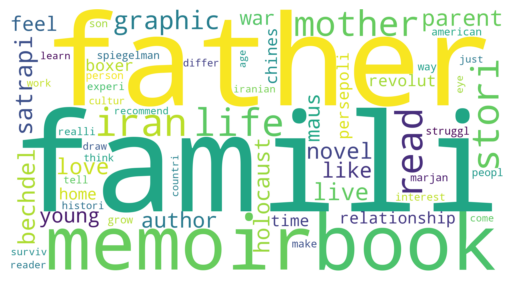

cluster size:  267


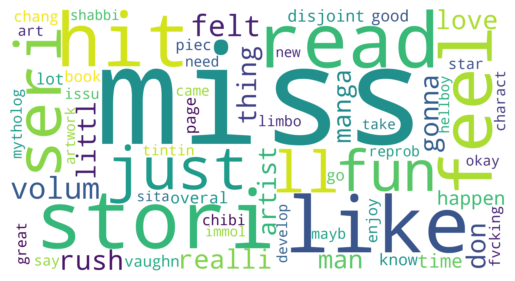

cluster size:  56


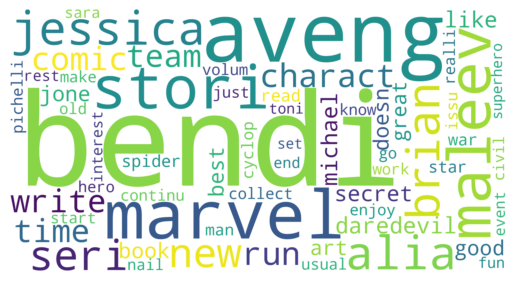

cluster size:  51


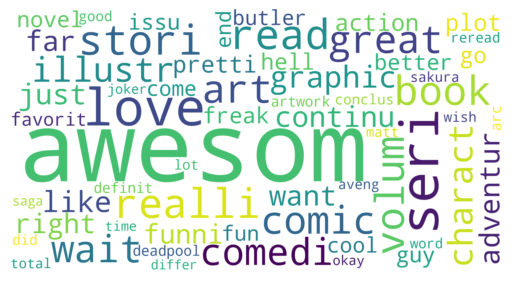

cluster size:  141


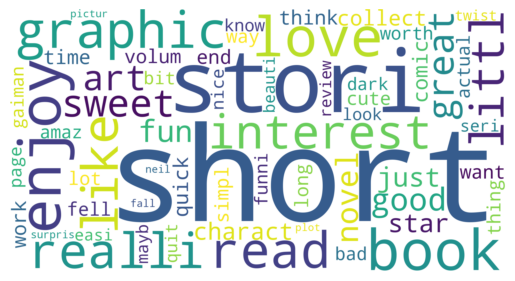

cluster size:  136


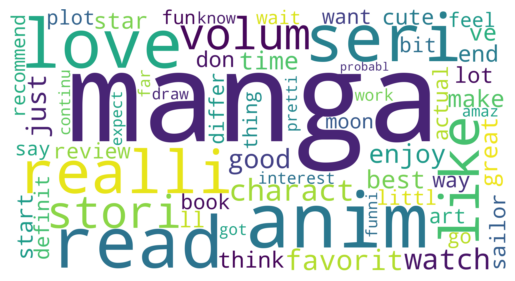

cluster size:  401


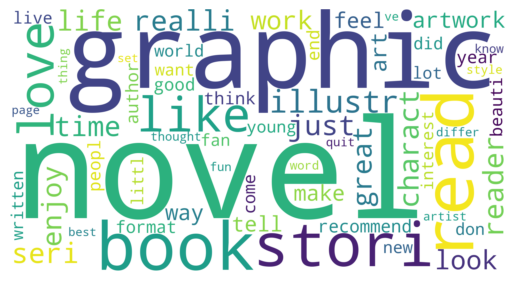

cluster size:  815


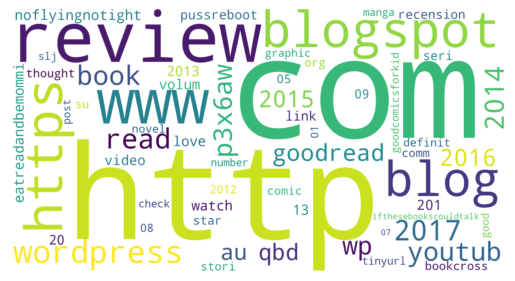

cluster size:  145


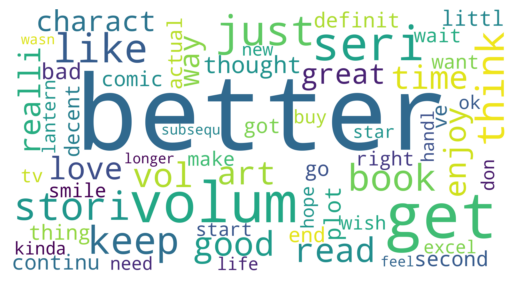

cluster size:  173


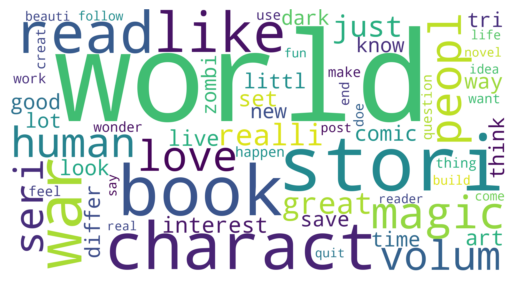

cluster size:  343


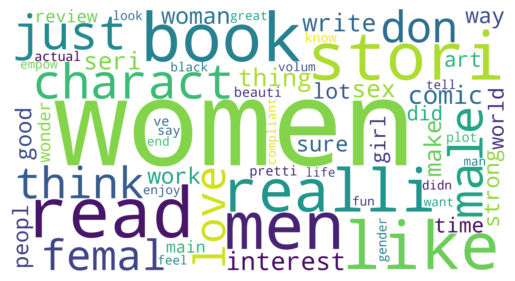

cluster size:  119


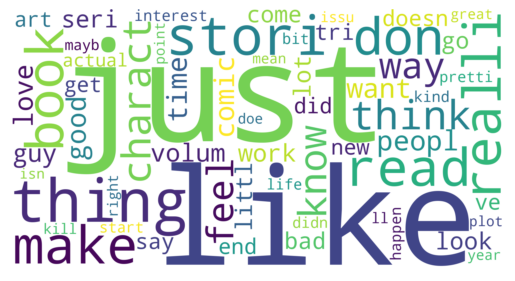

cluster size:  959


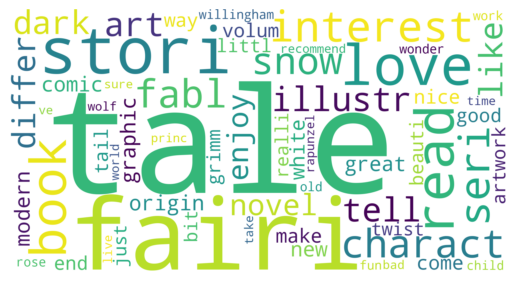

cluster size:  186


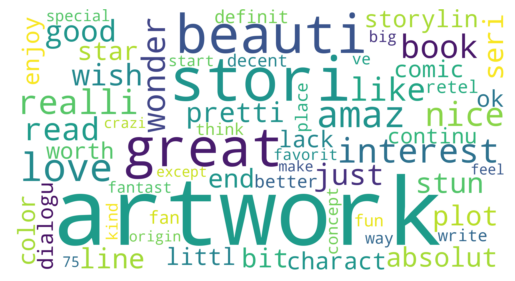

cluster size:  148


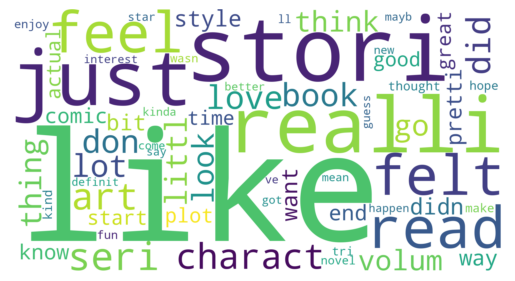

cluster size:  425


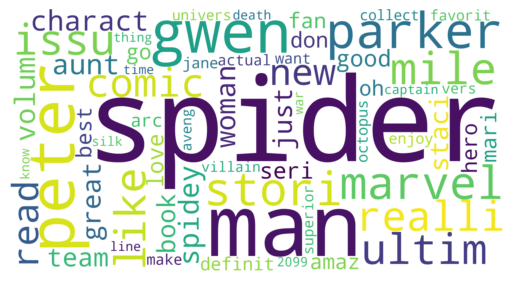

cluster size:  115


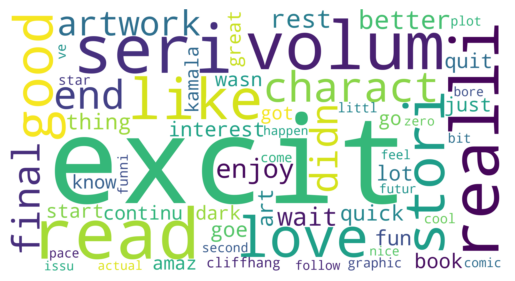

cluster size:  118


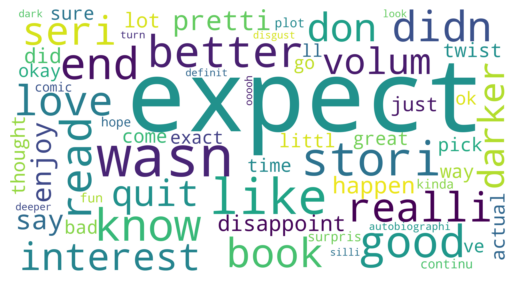

cluster size:  131


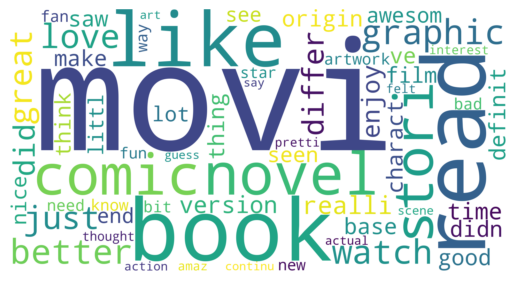

cluster size:  171


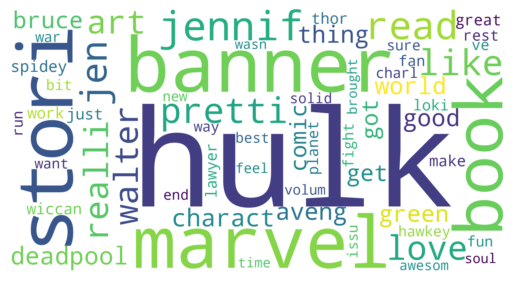

cluster size:  55


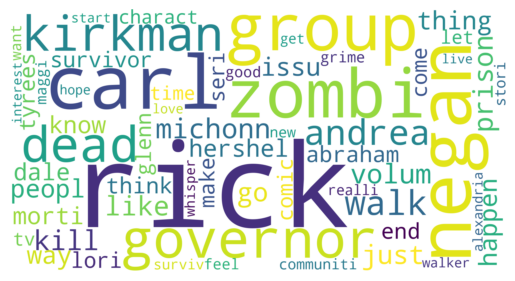

cluster size:  101


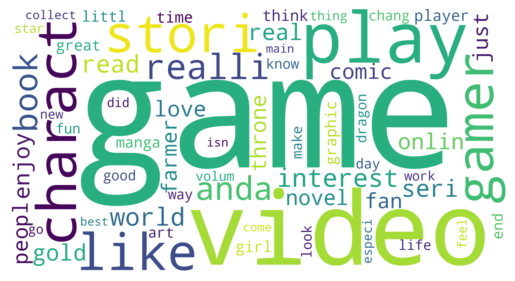

cluster size:  118


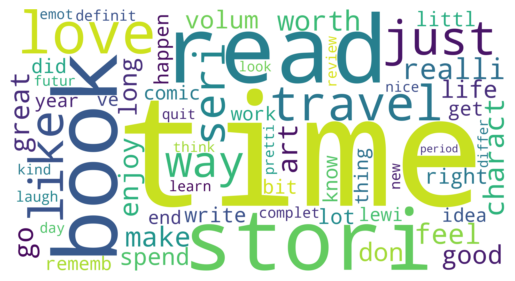

cluster size:  276


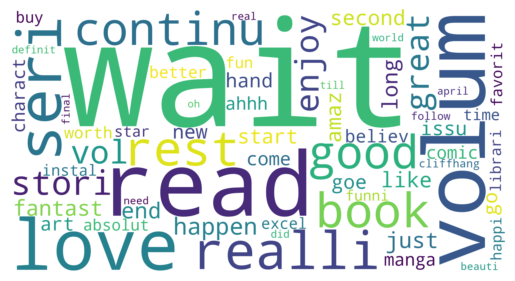

cluster size:  187


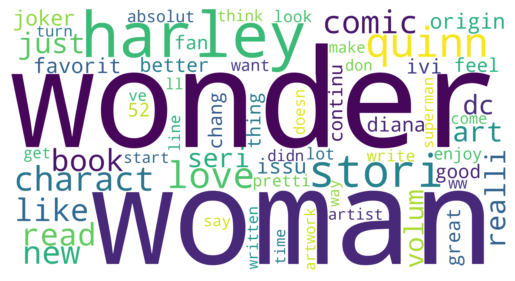

cluster size:  136


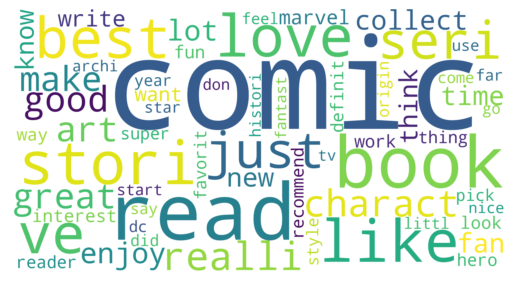

cluster size:  515


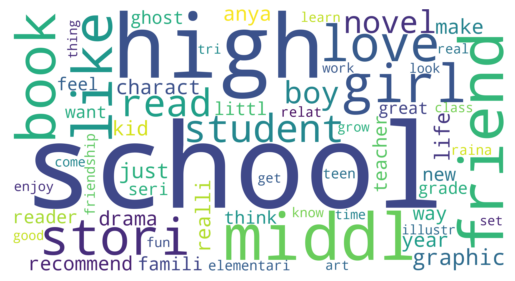

cluster size:  279


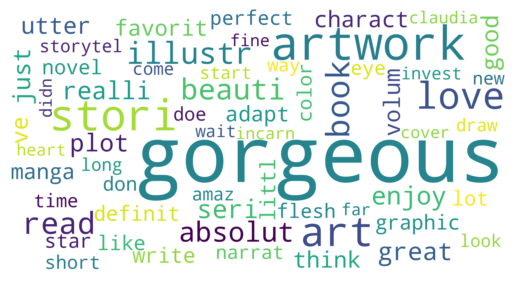

cluster size:  107


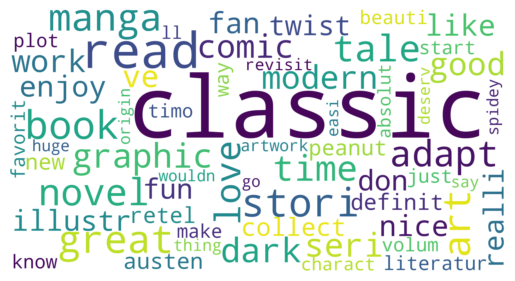

cluster size:  104


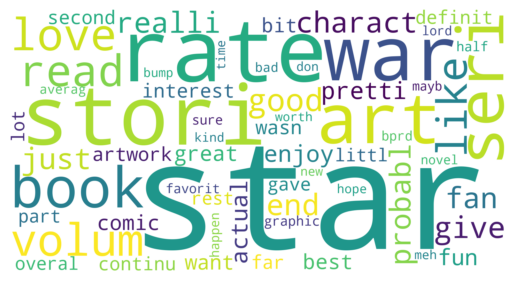

cluster size:  247


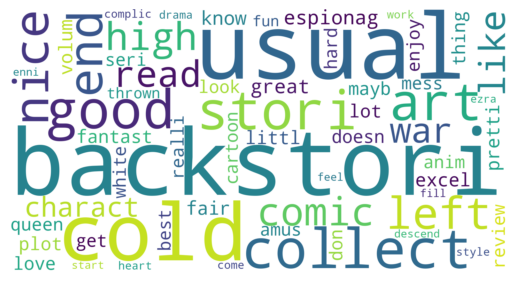

cluster size:  80


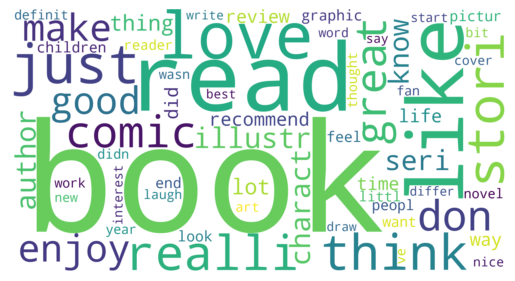

cluster size:  662


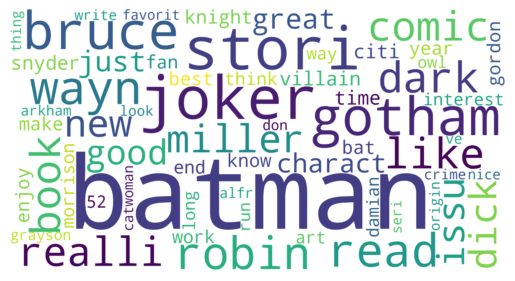

cluster size:  335


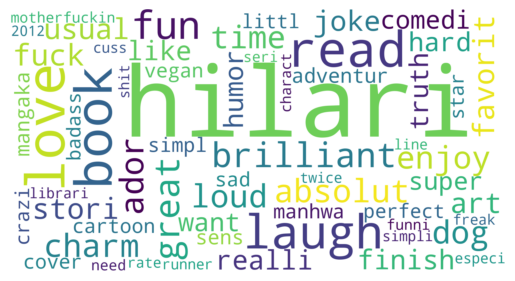

cluster size:  92


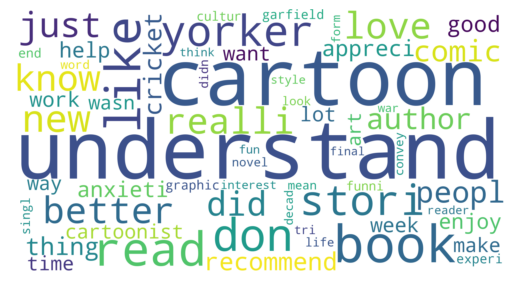

cluster size:  113


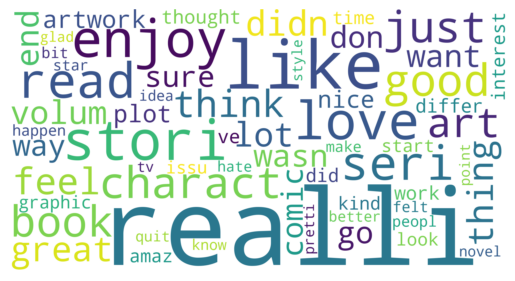

cluster size:  292


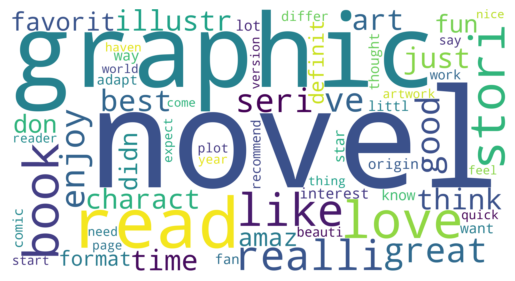

cluster size:  461


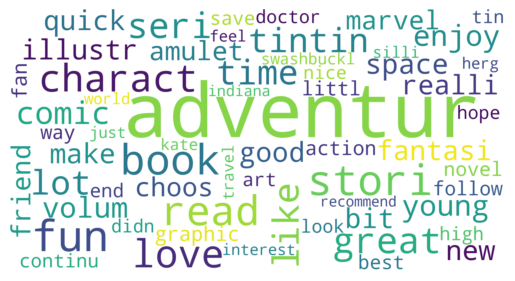

cluster size:  144


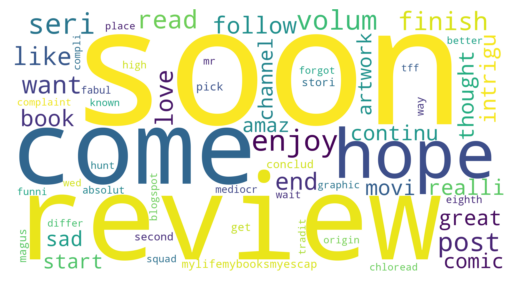

cluster size:  47


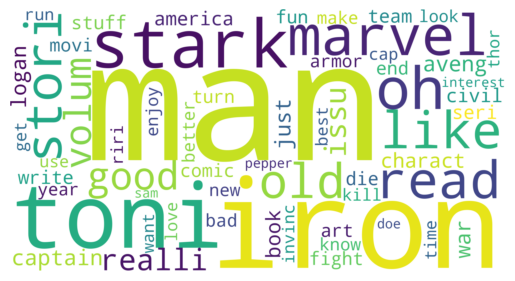

cluster size:  135


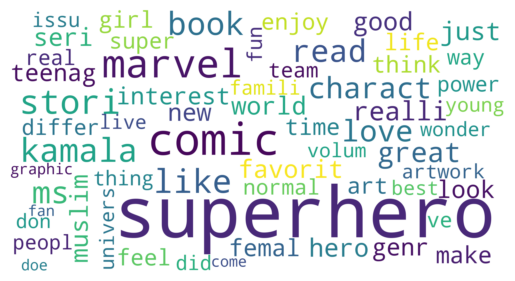

cluster size:  182


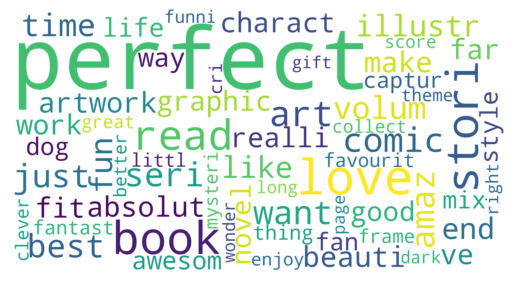

cluster size:  136


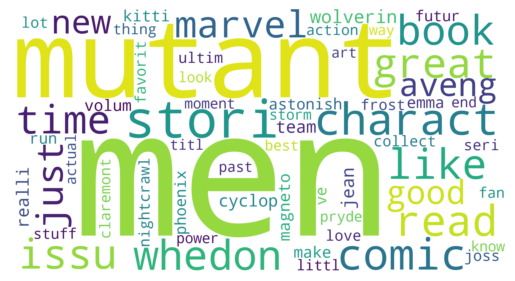

cluster size:  147


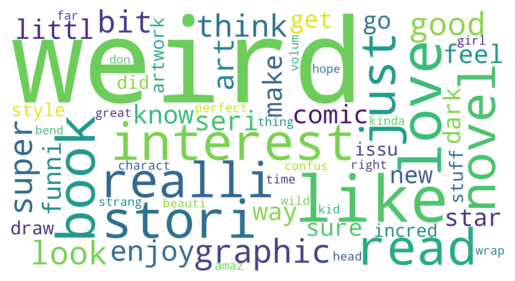

cluster size:  127


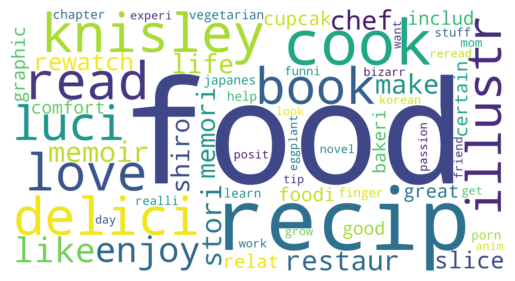

cluster size:  59


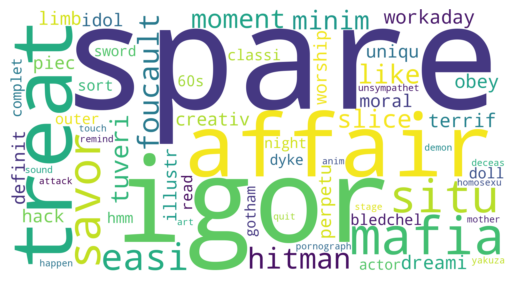

cluster size:  11


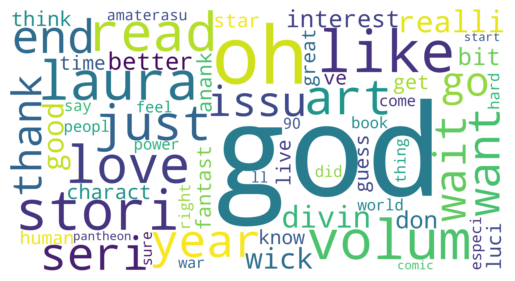

cluster size:  96


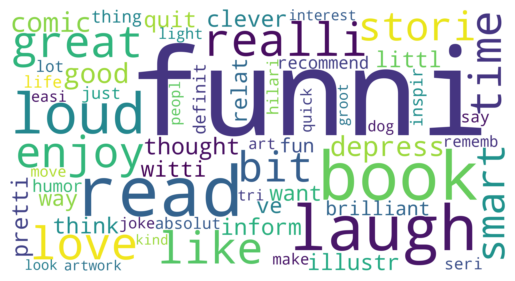

cluster size:  201


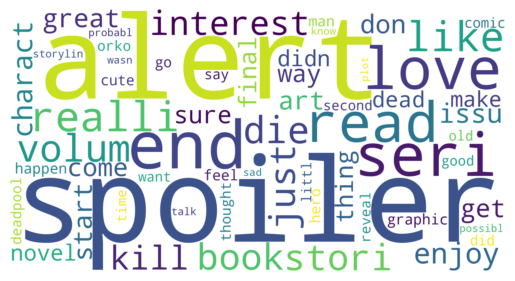

cluster size:  148


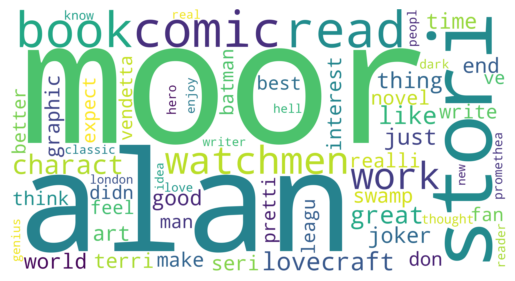

cluster size:  114


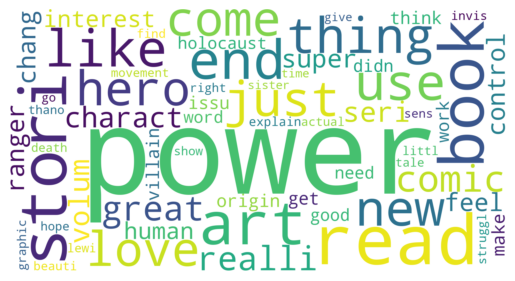

cluster size:  110


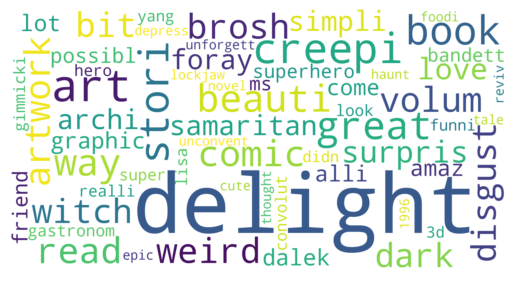

cluster size:  43


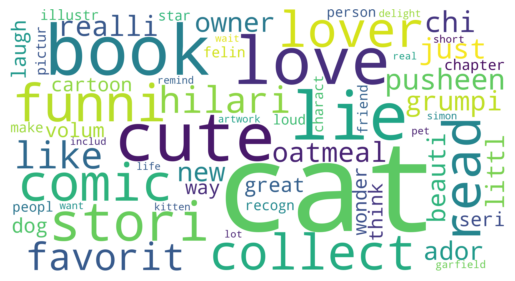

cluster size:  107


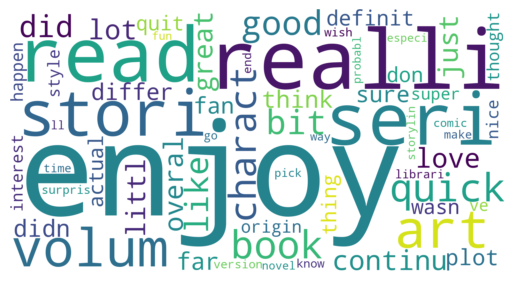

cluster size:  279


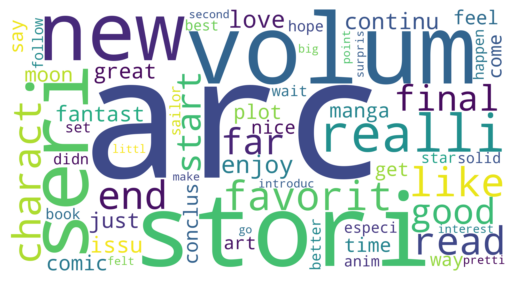

cluster size:  170


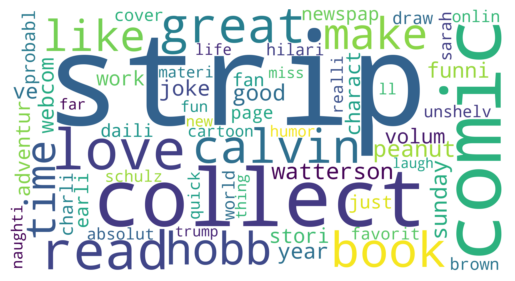

cluster size:  80


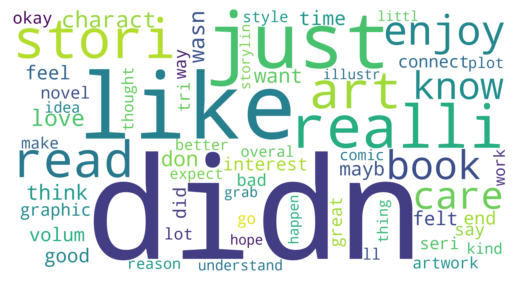

cluster size:  207


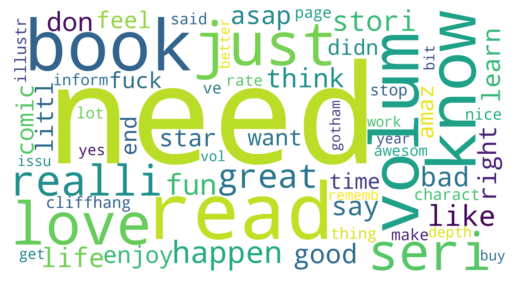

cluster size:  146


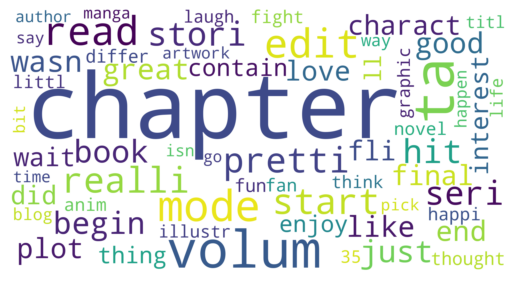

cluster size:  115


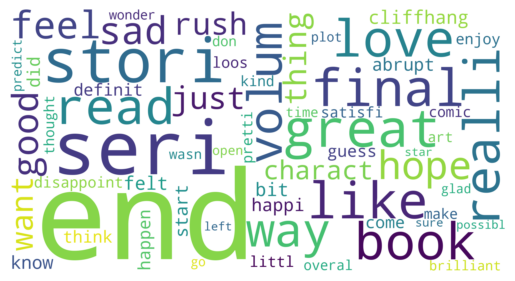

cluster size:  226


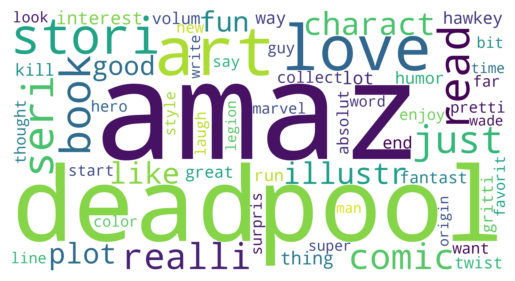

cluster size:  186


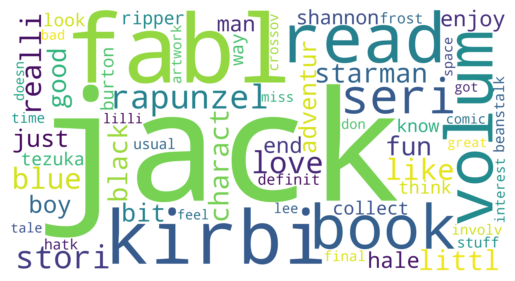

cluster size:  78


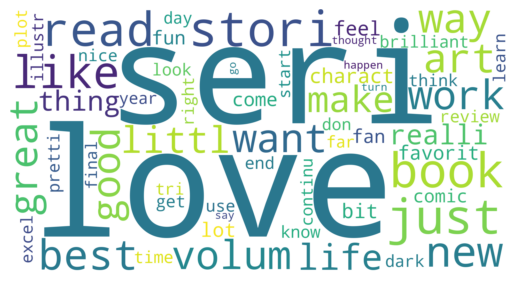

cluster size:  3136


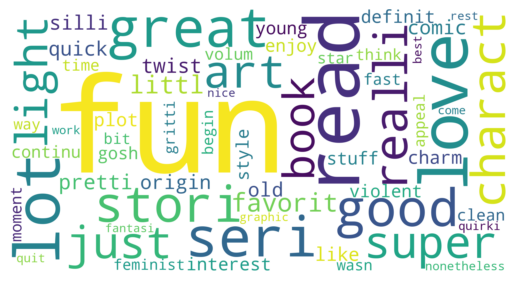

cluster size:  177


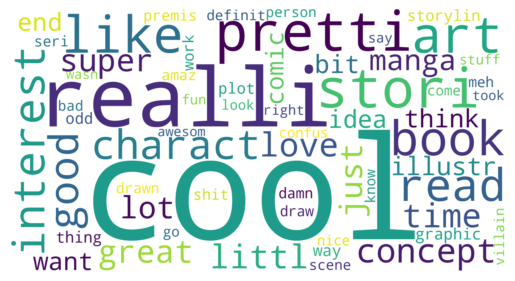

cluster size:  133


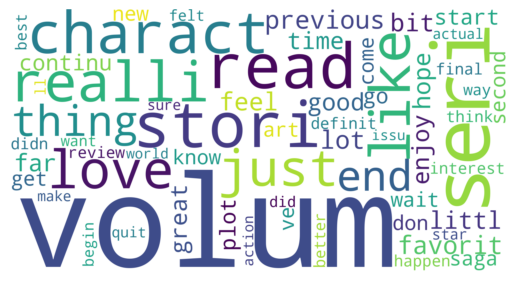

cluster size:  628


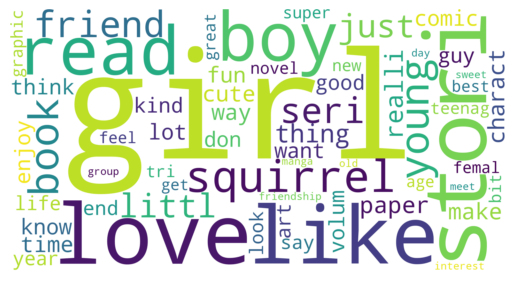

cluster size:  317


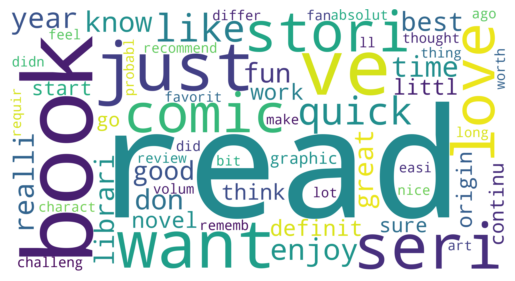

cluster size:  419


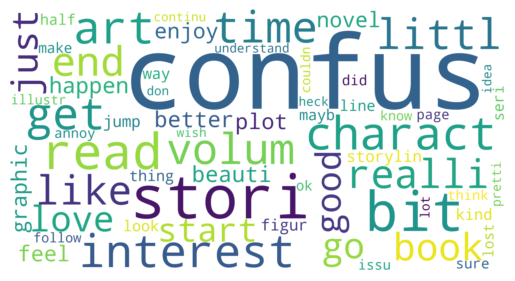

cluster size:  145


In [19]:
feature_names = vectorizer.get_feature_names_out()
dense = X_train.todense() # brings the vecs sparse matrix into regular matrix format
tfidf_df = pd.DataFrame(dense, columns=feature_names) # rows: reviews, cols: stemmed TF-IDF terms

for cluster_id in range(0,num_clusters):
  matching_indices = (km.labels_== cluster_id)  # Find reviews assigned to matching cluster_id
  word_tfidf = tfidf_df[matching_indices].T.sum(axis=1) # Sum TF-IDF scores for each word across those reviews
  word_cloud1 = WordCloud(collocations = False, background_color = 'white', max_words=60,
                          width = 2048, height = 1080).generate_from_frequencies(word_tfidf)
                          # instead of using frequencies, override with the tfidf val
  plt.imshow(word_cloud1, interpolation='bilinear')
  plt.axis("off")
  plt.show()
  print("cluster size: ",reviews[matching_indices].size)
  # print("-"+"\n-".join(txt for txt in np.random.choice(review_rating_df['review_text'][matching_indices],10)))

In [33]:
high_rating_clusters = []
low_rating_clusters = []

for cluster_id in range(num_clusters):
    matching_indices = (km.labels_ == cluster_id)
    cluster_ratings = review_rating_df.loc[matching_indices, 'rating']
    
    num_reviews = cluster_ratings.size
    num_high = (cluster_ratings > 2.5).sum()
    num_low = (cluster_ratings <= 2.5).sum()
    
    if num_high >= num_reviews - 2:
        high_rating_clusters.append(cluster_id)
    elif num_low >= num_reviews - 24:   # Raised the outlier constraint, there weren't any clusters with few positive reviews
        low_rating_clusters.append(cluster_id)

high_rating_clusters = high_rating_clusters[:3]
low_rating_clusters = low_rating_clusters[:3]

print("High-rating clusters:", high_rating_clusters)
print("Low-rating clusters:", low_rating_clusters)


High-rating clusters: [6, 12, 30]
Low-rating clusters: [32]


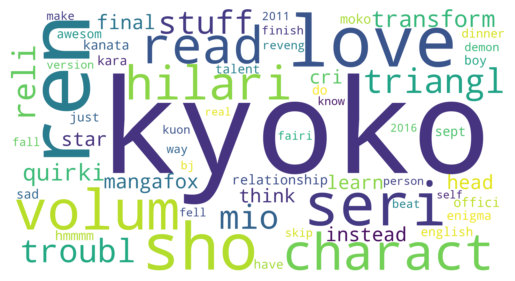

cluster size:  17
-I love this series. I'm finally reading the official English version. Kyoko is awesome!
-4 Stars. 
 Hmmmm, Ren being a little mean to Kyoko about all the stuff that happened in the last volume. The dinner scene was hilarious though!
-This was such a hilarious series! Kyoko was such a quirky character and was always doing stuff to get into trouble. I liked the transformation of her character throughout the series and how she found out that instead of having to rely on a boy she could make it on her own. There was a love triangle that I also enjoyed very much.
-4 Stars. 
 Okay, Sho is so in love with Kyoko, but he is such an idiot he doesn't know. The jealousy is actually rather adorable (I don't think they should get back together, but it is still interesting to read). The moment when Sho has that epiphany will be epic. 
 Re-Read 1: 
 Have to say, Sho is one messed up dude. He clearly loves Kyoko, but he's convinced himself he doesn't because he wants to be 'cool' - I

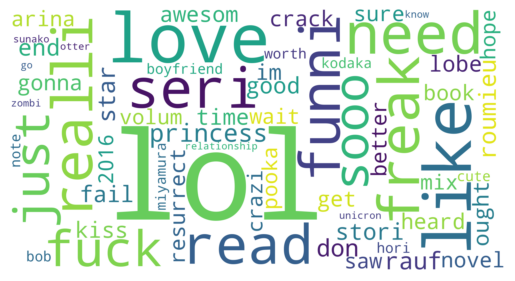

cluster size:  41
-i'm waiting for kiss,, #LOL
-Can I say that this story made me cry? Lol! It's so frustrating how the guy you lobe don't see you as someone worth it to love.
-OMG, Hazel! She's grown so much. I'm loving what an adorable kid she's becoming. One thing I really enjoy about this series is how it touches on social commentary in a very subtle way. War, domestic violence, xenophobia, sexuality, misogyny, race relations. All wrapped up in a kickass bow! In this issue we have an appearance of what I perceived to be a trans secondary character. Hoping we get to learn more about who this person is but I'm not holding my breath, lol secondary characters don't always get to shine. Onto the next installment!
-4.5 stars I liked this one, it was full of action and gory. The story line was interesting and I am for sure am going to read the next one but not just yet. Now I am gonna go back my novel i am half way through. lol.
-This comic book is just funny and ridiculous (in a good way

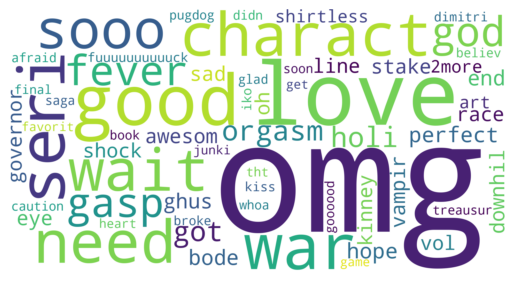

cluster size:  32
-Omg this book is ****ing awesome!!!!! I mean super man has gone mad and nightwing dead!!!!! And srsly superman a huge killer I hope flash goes to batsman side!!!!
-OH MY GOD!!!! Okay, let's clarify something: when i said i hoped we got back on the major story line again soon, I DIDN'T MEAN LIKE THIS!!!!! Omg, so much sadness in me right now! But, i AM glad we're back on the rails again. This series just keeps getting more interesting and i love it!!!
-This one got my heart racing. So good. Omg.
-OMG-this one was sooo good!!!
-OH OMG! 
 I am just so into this series I love it! 
 He Finally told her he loves her now it's getting even better, 
 Can't wait for next book!
-Omg this book is ****ing awesome!!!!! I mean super man has gone mad and nightwing dead!!!!! And srsly superman a huge killer I hope flash goes to batsman side!!!!
-OMG intense ending! OMG please don't tell me I need to wait 2more years for the next one. I might go crazy!
Perc of 0's:  0.0
Perc of 1's:  

In [48]:
feature_names = vectorizer.get_feature_names_out()
dense = X_train.todense() # brings the vecs sparse matrix into regular matrix format
tfidf_df = pd.DataFrame(dense, columns=feature_names) # rows: reviews, cols: stemmed TF-IDF terms

for cluster_id in high_rating_clusters:
    matching_indices = (km.labels_== cluster_id)  # Find reviews assigned to matching cluster_id
    word_tfidf = tfidf_df[matching_indices].T.sum(axis=1) # Sum TF-IDF scores for each word across those reviews
    word_cloud1 = WordCloud(collocations = False, background_color = 'white', max_words=60,
                            width = 2048, height = 1080).generate_from_frequencies(word_tfidf)
                            # instead of using frequencies, override with the tfidf val
    plt.imshow(word_cloud1, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    print("cluster size: ",reviews[matching_indices].size)
    print("-"+"\n-".join(txt for txt in np.random.choice(review_rating_df['review_text'][matching_indices],7)))
    
    cluster_ratings = review_rating_df['rating'][matching_indices]
    total_cluster_ratings = len(cluster_ratings)
    print("Perc of 0's: ", (cluster_ratings == 0).sum() / total_cluster_ratings)
    print("Perc of 1's: ", (cluster_ratings == 1).sum() / total_cluster_ratings)
    print("Perc of 2's: ", (cluster_ratings == 2).sum() / total_cluster_ratings)
    print("Perc of 3's: ", (cluster_ratings == 3).sum() / total_cluster_ratings)
    print("Perc of 4's: ", (cluster_ratings == 4).sum() / total_cluster_ratings)
    print("Perc of 5's: ", (cluster_ratings == 5).sum() / total_cluster_ratings)


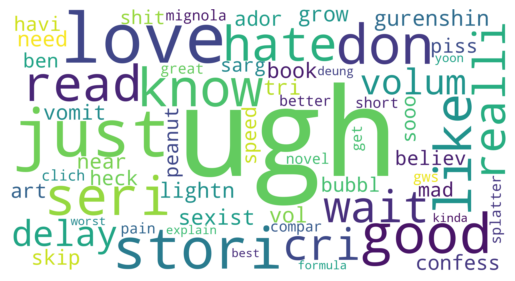

cluster size:  34
-Ugh. The delayed confessions!
-I'm so mad at the ending. Ugh, I hope the movie is better.
-Ugh, sci-fi samurai with Frank Miller splatters, what more could you ever ask for <3
-These are seriously growing on me. I'm addicted to the story line. It's cheesy and, in some instances, very formulaic, but ugh, love it.
-I had to skip the part where Max was getting the chip removed from her arm, gross, and also, the declaration of love, ugh.
-This is my first experience with non-Mike Mignola Hellboys. Obviously the ones that Mignola did were the best. The Vampire of Prague was also good; different but good. I hated Mokoma. Hated it. Hated it. Ugh it was the worst.
-Sexist and kinda cliched, ugh.
Perc of 0's:  0.058823529411764705
Perc of 1's:  0.11764705882352941
Perc of 2's:  0.11764705882352941
Perc of 3's:  0.14705882352941177
Perc of 4's:  0.20588235294117646
Perc of 5's:  0.35294117647058826


In [50]:
feature_names = vectorizer.get_feature_names_out()
dense = X_train.todense() # brings the vecs sparse matrix into regular matrix format
tfidf_df = pd.DataFrame(dense, columns=feature_names) # rows: reviews, cols: stemmed TF-IDF terms

for cluster_id in low_rating_clusters:
    matching_indices = (km.labels_== cluster_id)  # Find reviews assigned to matching cluster_id
    word_tfidf = tfidf_df[matching_indices].T.sum(axis=1) # Sum TF-IDF scores for each word across those reviews
    word_cloud1 = WordCloud(collocations = False, background_color = 'white', max_words=60,
                            width = 2048, height = 1080).generate_from_frequencies(word_tfidf)
                            # instead of using frequencies, override with the tfidf val
    plt.imshow(word_cloud1, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    print("cluster size: ",reviews[matching_indices].size)
    print("-"+"\n-".join(txt for txt in np.random.choice(review_rating_df['review_text'][matching_indices],7)))

    cluster_ratings = review_rating_df['rating'][matching_indices]
    total_cluster_ratings = len(cluster_ratings)
    print("Perc of 0's: ", (cluster_ratings == 0).sum() / total_cluster_ratings)
    print("Perc of 1's: ", (cluster_ratings == 1).sum() / total_cluster_ratings)
    print("Perc of 2's: ", (cluster_ratings == 2).sum() / total_cluster_ratings)
    print("Perc of 3's: ", (cluster_ratings == 3).sum() / total_cluster_ratings)
    print("Perc of 4's: ", (cluster_ratings == 4).sum() / total_cluster_ratings)
    print("Perc of 5's: ", (cluster_ratings == 5).sum() / total_cluster_ratings)

In [25]:
negative_count = (review_rating_df['rating'] < 2.5).sum()
positive_count = (review_rating_df['rating'] >= 2.5).sum()

print(negative_count)
print(positive_count)


2705
20507


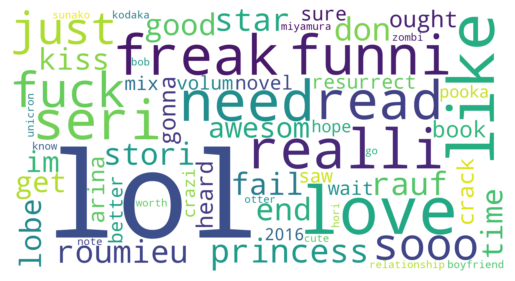

cluster size:  41
-Sooo didnt like the art.. and i read this fairly quickly as it was gonna expire lol.. so i cant say i did the comic justice nor the art did me.. im sorry.. i think i will read the book.. if i do get the chance.. otherwise nah..
-Cool idea and all, but Morrison has to throw his craziness in the works. LOL Worth a read, but prepare to see some really good parts mixed with slight insanity.
-i'm waiting for kiss,, #LOL
-Loved the insight into my cats lives, lol. The Bob's were pretty funny too!
-Mangas are deep don't let the nice faces fool ya. This artist is cold hearted but I don't mind lol great volumes
-i really need more princess resurrection now!!! lol!!!!!
-Lol i love this book to and it was soo funny when senri licked roses blood it was like he was a vampire hehehehhe
Perc of 0's:  0.024390243902439025
Perc of 1's:  0.024390243902439025
Perc of 2's:  0.0
Perc of 3's:  0.17073170731707318
Perc of 4's:  0.34146341463414637
Perc of 5's:  0.43902439024390244
Sooo did

In [52]:
feature_names = vectorizer.get_feature_names_out()
dense = X_train.todense() # brings the vecs sparse matrix into regular matrix format
tfidf_df = pd.DataFrame(dense, columns=feature_names) # rows: reviews, cols: stemmed TF-IDF terms

cluster_id = 12
matching_indices = (km.labels_== cluster_id)  # Find reviews assigned to matching cluster_id
word_tfidf = tfidf_df[matching_indices].T.sum(axis=1) # Sum TF-IDF scores for each word across those reviews
word_cloud1 = WordCloud(collocations = False, background_color = 'white', max_words=60,
                        width = 2048, height = 1080).generate_from_frequencies(word_tfidf)
                        # instead of using frequencies, override with the tfidf val
plt.imshow(word_cloud1, interpolation='bilinear')
plt.axis("off")
plt.show()
print("cluster size: ",reviews[matching_indices].size)
print("-"+"\n-".join(txt for txt in np.random.choice(review_rating_df['review_text'][matching_indices],7)))

cluster_ratings = review_rating_df['rating'][matching_indices]
total_cluster_ratings = len(cluster_ratings)
print("Perc of 0's: ", (cluster_ratings == 0).sum() / total_cluster_ratings)
print("Perc of 1's: ", (cluster_ratings == 1).sum() / total_cluster_ratings)
print("Perc of 2's: ", (cluster_ratings == 2).sum() / total_cluster_ratings)
print("Perc of 3's: ", (cluster_ratings == 3).sum() / total_cluster_ratings)
print("Perc of 4's: ", (cluster_ratings == 4).sum() / total_cluster_ratings)
print("Perc of 5's: ", (cluster_ratings == 5).sum() / total_cluster_ratings)
low_outlier = review_rating_df[matching_indices]
low_outlier = low_outlier[low_outlier['rating'] <= 1]['review_text']

for review in low_outlier:
    print(review)
    print("-" * 80)  




I picked three clusters with less than 2 low ratings (0 or 1). Only one cluster had two low ratings. When I look at the text with rating 1, I think that there were very few negative words in it, "didnt" was pretty much it. I think that it had far more neutral words to cover up for the negative ones. When I look at the text with rating 0, I think that the review had sarcasm in it. The review used words like "interesting" but with opposite intent. 

The cluster with the least amount of positive ratings (24) still had a majority of positive reviews. I think that it was tough to find a cluster with few positive reviews because of the imbalance of positive and negative reviews (20000 to 3000) split. It is impossible to say there are outliers in this cluster, if the majority is positive. 

new_reviews = [
    "kyoko is a lovely place", Cluster 6 has an important word "kyoko"
    "lol, i have never laughed so much", Cluster 12 has an important word "lol"
    "omg, i am going to read this again", Cluster 30 has an important word "omg"
    "Ugh, this was awful", Cluster 32 has an important word "ugh"
]



In [54]:
new_reviews = [
    "kyoko is a lovely place",
    "lol, i have never laughed so much",
    "omg, i am going to read this again",
    "Ugh, this was awful"
]

existing_reviews = review_rating_df['review_text'].str.lower()

# Check if any new review already exists
for review in new_reviews:
    if review.lower() in existing_reviews.values:
        print(f"Review already exists: {review}")
    else:
        print(f"Review is new: {review}")


Review is new: kyoko is a lovely place
Review is new: lol, i have never laughed so much
Review is new: omg, i am going to read this again
Review is new: Ugh, this was awful


In [55]:
X_new = vectorizer.transform(new_reviews)
new_clusters = km.predict(X_new)
for review, cluster in zip(new_reviews, new_clusters):
    print(f"Review: '{review}' → Cluster: {cluster}")

Review: 'kyoko is a lovely place' → Cluster: 6
Review: 'lol, i have never laughed so much' → Cluster: 12
Review: 'omg, i am going to read this again' → Cluster: 30
Review: 'Ugh, this was awful' → Cluster: 32


In [56]:
def dist_norm(v1, v2):
  v1_normalized = v1/np.linalg.norm(v1) #Normalize vectors to unit length
  v2_normalized = v2/np.linalg.norm(v2)
  delta = v1_normalized-v2_normalized   #Then take distance
  return np.linalg.norm(delta)

In [57]:
for i, new_vec in enumerate(X_new):
    new_vec_dense = new_vec.toarray().flatten()
    distances = [dist_norm(new_vec_dense, center) for center in km.cluster_centers_]
    closest_cluster = np.argmin(distances)
    print(f"Review: '{new_reviews[i]}'")
    print(f"Closest cluster: {closest_cluster}")
    print(f"Distances to clusters (first 5): {distances[:5]}")
    print("-" * 60)


Review: 'kyoko is a lovely place'
Closest cluster: 6
Distances to clusters (first 5): [np.float64(1.3888014058571971), np.float64(1.396833180566745), np.float64(1.3823776973695026), np.float64(1.3933969952759768), np.float64(1.3950799782319636)]
------------------------------------------------------------
Review: 'lol, i have never laughed so much'
Closest cluster: 12
Distances to clusters (first 5): [np.float64(1.4059874882610777), np.float64(1.4008010331858687), np.float64(1.4111483777671228), np.float64(1.4118095268120079), np.float64(1.4106115777771309)]
------------------------------------------------------------
Review: 'omg, i am going to read this again'
Closest cluster: 30
Distances to clusters (first 5): [np.float64(1.3732535295188495), np.float64(1.3822036209327275), np.float64(1.3748754429247256), np.float64(1.3706165863205453), np.float64(1.3934111157631526)]
------------------------------------------------------------
Review: 'Ugh, this was awful'
Closest cluster: 32
Dist

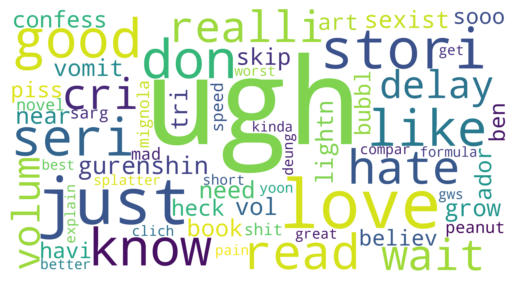

cluster size:  34
-Ugh. This was a terrible graphic novel. I only bought it because Mark Millar (Kick-Ass) wrote it. The story is predictable, and I can't tell the two girls apart. Also, I don't like what it's trying to imply by naming the characters Richard, Ben, Mary and May. :-/ I already gave away my copy. :(
-Sort of the bad elements of Hama's later run on the original series with very few of the good. Brainwave scanner? Really? Wasn't that nearly universally hated? So we make it nearly the true center of the story? Ugh.
-Ugh why was this so short?? I need more! I'm reading through them at lightning speed
-Ugh man I don't know how to rate this but I think 4 stars would be more accurate :P 
 "Call me Sarge!!" 
 lol. 
 I personally enjoyed it. The moral in this one it's heartwarming :)
-Ugh, Light is pissing me off so much - and L is just more and more adorable and awesome. This series is amazing.
-Il-Deung offered Yoon Ah a deal, a pathetic deal. Ugh.
-These are seriously growing o

In [53]:
feature_names = vectorizer.get_feature_names_out()
dense = X_train.todense() # brings the vecs sparse matrix into regular matrix format
tfidf_df = pd.DataFrame(dense, columns=feature_names) # rows: reviews, cols: stemmed TF-IDF terms

cluster_id = 32
matching_indices = (km.labels_== cluster_id)  # Find reviews assigned to matching cluster_id
word_tfidf = tfidf_df[matching_indices].T.sum(axis=1) # Sum TF-IDF scores for each word across those reviews
word_cloud1 = WordCloud(collocations = False, background_color = 'white', max_words=60,
                        width = 2048, height = 1080).generate_from_frequencies(word_tfidf)
                        # instead of using frequencies, override with the tfidf val
plt.imshow(word_cloud1, interpolation='bilinear')
plt.axis("off")
plt.show()
print("cluster size: ",reviews[matching_indices].size)
print("-"+"\n-".join(txt for txt in np.random.choice(review_rating_df['review_text'][matching_indices],7)))

cluster_ratings = review_rating_df['rating'][matching_indices]
total_cluster_ratings = len(cluster_ratings)
print("Perc of 0's: ", (cluster_ratings == 0).sum() / total_cluster_ratings)
print("Perc of 1's: ", (cluster_ratings == 1).sum() / total_cluster_ratings)
print("Perc of 2's: ", (cluster_ratings == 2).sum() / total_cluster_ratings)
print("Perc of 3's: ", (cluster_ratings == 3).sum() / total_cluster_ratings)
print("Perc of 4's: ", (cluster_ratings == 4).sum() / total_cluster_ratings)
print("Perc of 5's: ", (cluster_ratings == 5).sum() / total_cluster_ratings)
low_outlier = review_rating_df[matching_indices]
low_outlier = low_outlier[low_outlier['rating'] <= 1]['review_text']

for review in low_outlier:
    print(review)
    print("-" * 80)  




In [64]:
rating_clusters = {i: [] for i in range(6)}  

for cluster_id in range(num_clusters):
    matching_indices = (km.labels_ == cluster_id)
    cluster_ratings = review_rating_df.loc[matching_indices, 'rating']
    num_reviews = cluster_ratings.size

    for rating in range(6):
        if (cluster_ratings == rating).sum() >= num_reviews - 50:
            rating_clusters[rating].append(cluster_id)
            break  

for rating in range(6):
    rating_clusters[rating] = rating_clusters[rating][:3]
    print(f"{rating}-rating clusters:", rating_clusters[rating])


0-rating clusters: [6, 8, 12]
1-rating clusters: [52]
2-rating clusters: [31, 35]
3-rating clusters: [34, 77, 94]
4-rating clusters: [22, 63]
5-rating clusters: [7, 66]


In [65]:
selected_clusters = rating_clusters[0] + rating_clusters[1] + rating_clusters[2] + \
                    rating_clusters[3] + rating_clusters[4] + rating_clusters[5]

for cluster_id in selected_clusters:
    matching_indices = (km.labels_ == cluster_id)
    cluster_ratings = review_rating_df.loc[matching_indices, 'rating']
    total = len(cluster_ratings)

    print(f"\nCluster {cluster_id} — Total Reviews: {total}")
    for rating in range(6):  # Ratings from 0 to 5
        count = (cluster_ratings == rating).sum()
        percent = (count / total) * 100 if total > 0 else 0
        print(f"  Rating {rating}: {percent:.2f}%")



Cluster 6 — Total Reviews: 17
  Rating 0: 0.00%
  Rating 1: 0.00%
  Rating 2: 0.00%
  Rating 3: 0.00%
  Rating 4: 52.94%
  Rating 5: 47.06%

Cluster 8 — Total Reviews: 46
  Rating 0: 0.00%
  Rating 1: 0.00%
  Rating 2: 10.87%
  Rating 3: 34.78%
  Rating 4: 30.43%
  Rating 5: 23.91%

Cluster 12 — Total Reviews: 41
  Rating 0: 2.44%
  Rating 1: 2.44%
  Rating 2: 0.00%
  Rating 3: 17.07%
  Rating 4: 34.15%
  Rating 5: 43.90%

Cluster 52 — Total Reviews: 55
  Rating 0: 0.00%
  Rating 1: 9.09%
  Rating 2: 10.91%
  Rating 3: 29.09%
  Rating 4: 30.91%
  Rating 5: 20.00%

Cluster 31 — Total Reviews: 52
  Rating 0: 0.00%
  Rating 1: 1.92%
  Rating 2: 7.69%
  Rating 3: 15.38%
  Rating 4: 46.15%
  Rating 5: 28.85%

Cluster 35 — Total Reviews: 51
  Rating 0: 0.00%
  Rating 1: 0.00%
  Rating 2: 9.80%
  Rating 3: 25.49%
  Rating 4: 35.29%
  Rating 5: 29.41%

Cluster 34 — Total Reviews: 56
  Rating 0: 3.57%
  Rating 1: 1.79%
  Rating 2: 8.93%
  Rating 3: 33.93%
  Rating 4: 35.71%
  Rating 5: 16.07%


The clusters were weakly able to separate between the different rating valeus. 
Of Rating 5, there was two clusters of 56% and 60% majority. 
Of Rating 4, there were two clusters of 38% and one of 50%
Of Rating 3, there were none above 35%
Of Rating 2,1,0, there were none above 10%

For the ratings 3 and lower, I think this is hard to separate when there are such low negative reviews. However, even for the ratings of 4 and 5, the clusters were decently able to separate by 4's and 5's


In [ ]:
from sklearn.decomposition import PCA


In [68]:
review_rating_df.reset_index(drop=True, inplace=True)

In [69]:
vectorizer = StemmedTfidfVectorizer(min_df=1, max_features=5000, stop_words='english') # All words are included (even rare words) and stop words are removed
X_train = vectorizer.fit_transform(review_rating_df["review_text"])


In [70]:
pca = PCA(n_components=3)
components = pca.fit_transform(X_train.toarray())


In [71]:
components_df = pd.DataFrame(components, columns=["PC1", "PC2", "PC3"])
components_df["rating"] = review_rating_df["rating"].values
components_df["review_text"] = review_rating_df["review_text"].values
components_df["doc_id"] = review_rating_df.index.astype(str)
print(components_df.shape)

(23212, 6)


In [85]:
%pip install nbformat

Note: you may need to restart the kernel to use updated packages.


'DOSKEY' is not recognized as an internal or external command,
operable program or batch file.

[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
import plotly.express as px


In [72]:
fig = px.scatter_matrix(components_df, dimensions=["PC1", "PC2", "PC3"], color="rating", 
    title="PCA Scatter Matrix of TF-IDF Reviews Colored by Rating")
fig.update_traces(diagonal_visible=False)
fig.show()

In [73]:
fig = px.scatter_3d(components_df, x = "PC1", y="PC2",  z = "PC3", hover_name="doc_id")
fig.show()

In [74]:
fig = px.scatter(
    components_df,
    x="PC1",
    y="PC2",
    color="rating",
    hover_name="doc_id", 
    hover_data=["rating", "review_text"]
)
fig.show()


I set max features to 5000 to take up less ram for computing PCA. the tf-idf matrix is sparse, with many "less important" features, therefore it is reasonable to reduce the feature space. When I look at PC1 vs PC2, along the PC1 axis I notice that the larger the score the more I see review text using "love". I see a review that has a 1 rating that uses the word "love", which is pretty far away from most of the lowly rated reviews. It almost makes me think that some of these 0 rated reviews are just people that didn't leave a review and the default is 0. The ones that I have listed below are comments where the reviewer loves a character, but didn't like the story. I think that having the word in the low rated review is what created such distance from the other low rated reviews. 

10877 and 15403

First 10 explained variance ratios: [0.00833586 0.00730592 0.00676505 0.00584202 0.00557326 0.00500054
 0.0046648  0.00445198 0.00420622 0.00407744]
First 10 cumulative variance values: [0.00833586 0.01564178 0.02240683 0.02824885 0.03382212 0.03882266
 0.04348746 0.04793944 0.05214566 0.05622309]
Components needed for 50% variance: 473


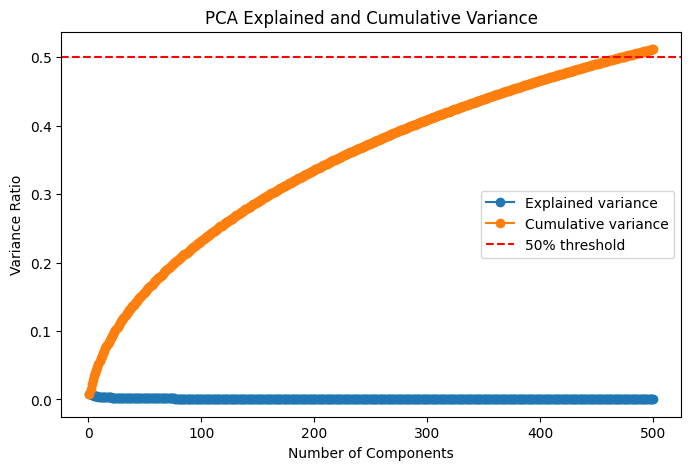

In [82]:
import matplotlib.pyplot as plt

pca = PCA(n_components=500)
pca.fit(X_train.toarray())

# Get explained variance ratios
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Print first few values to verify
print("First 10 explained variance ratios:", explained_variance[:10])
print("First 10 cumulative variance values:", cumulative_variance[:10])

# Find number of components needed to exceed 50% variance
target = 0.50  # 50%
n_components_50 = np.argmax(cumulative_variance >= target) + 1
print(f"Components needed for 50% variance: {n_components_50}")



# Plot
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
plt.plot(np.arange(1, len(explained_variance)+1), explained_variance, marker='o', label='Explained variance')
plt.plot(np.arange(1, len(cumulative_variance)+1), cumulative_variance, marker='o', label='Cumulative variance')
plt.axhline(y=0.5, color='r', linestyle='--', label='50% threshold')
plt.xlabel('Number of Components')
plt.ylabel('Variance Ratio')
plt.title('PCA Explained and Cumulative Variance')
plt.legend()
plt.show()



There are 5000 features for this dataset. When I computed 3 components earlier, this accounted for 2.2% of the variance. In order to get across the 50% thresold, the minimum number of components needed are 473. 

In [60]:
review_outlier = components_df[components_df['doc_id'] == "15403"]
print(review_outlier['rating'])

15403    1
Name: rating, dtype: int64


In [27]:
# Create a list of equations for each principal component
feature_names = vectorizer.get_feature_names_out()

for i in range(len(pca.components_)):
  equation = ''
  for j in range(len(feature_names)):
    if j > 0:
      equation += ' + '
    equation += str(round(pca.components_[i][j], 2)) + '*' + feature_names[j]
  print('PC' + str(i+1) + ' = ' + equation)

PC1 = -0.0*000 + -0.0*01 + -0.0*10 + -0.0*100 + -0.0*11 + -0.0*12 + -0.0*13 + -0.0*14 + -0.0*15 + -0.0*16 + -0.0*17 + -0.0*18 + -0.0*19 + -0.0*1930s + -0.0*1940s + -0.0*1950s + -0.0*1960s + -0.0*1970s + -0.0*1980s + -0.0*1986 + -0.0*1990s + -0.0*19th + -0.0*1st + -0.0*20 + -0.0*200 + -0.0*2000 + -0.0*2003 + 0.0*2005 + -0.0*2008 + -0.0*2009 + -0.0*2010 + -0.0*2011 + -0.0*2012 + -0.0*2013 + -0.0*2014 + -0.0*2015 + -0.0*2016 + -0.0*2017 + -0.0*20th + -0.0*21 + -0.0*21st + -0.0*22 + -0.0*23 + -0.0*24 + -0.0*25 + -0.0*26 + -0.0*27 + -0.0*28 + -0.0*2nd + -0.0*30 + -0.0*300 + -0.0*30s + -0.0*31 + -0.0*32 + -0.0*35 + -0.0*37 + 0.0*3rd + -0.0*40 + -0.0*45 + 0.0*4th + -0.0*50 + -0.0*500 + -0.0*50s + -0.0*52 + 0.0*5th + -0.0*60 + -0.0*60s + -0.0*66 + -0.0*70 + -0.0*70s + -0.0*75 + 0.0*7th + -0.0*80 + -0.0*80s + -0.0*8th + -0.0*90 + -0.0*90s + -0.0*99 + 0.0*aang + -0.0*aaron + -0.0*abandon + -0.0*abduct + -0.0*abe + -0.0*abil + -0.0*abl + -0.0*abort + -0.0*abound + -0.0*abraham + -0.0*abrupt + -0.

In [28]:
# Get original feature names from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Loop through each principal component
for i in range(len(pca.components_)):
    equation = ''
    for j in range(len(feature_names)):
        coef = round(pca.components_[i][j], 2)
        if coef != 0:  # SparsePCA will have many zeros
            if equation:
                equation += ' + '
            equation += f'{coef}*{feature_names[j]}'
    print(f'PC{i+1} = {equation}')


PC1 = 0.02*absolut + -0.01*action + -0.02*actual + -0.01*add + 0.01*ador + -0.01*adult + -0.01*age + -0.01*alien + -0.01*allow + 0.03*amaz + -0.01*america + -0.01*american + 0.01*anim + -0.01*appear + -0.01*appreci + -0.01*arc + -0.01*aren + 0.03*art + -0.01*artist + -0.01*attempt + -0.01*aveng + -0.01*away + 0.02*awesom + -0.02*bad + -0.01*base + -0.01*basic + -0.03*batman + -0.01*battl + 0.01*beauti + -0.01*begin + -0.01*best + -0.02*better + -0.01*big + -0.02*bit + -0.01*black + -0.04*book + -0.01*bore + -0.01*bring + -0.01*bruce + -0.01*build + -0.01*call + -0.01*captain + -0.01*care + -0.01*case + 0.01*cat + -0.01*certain + -0.01*chang + -0.01*chapter + -0.01*citi + -0.01*clear + -0.01*collect + -0.01*color + -0.02*come + -0.04*comic + -0.01*confus + -0.01*consid + -0.01*contain + -0.01*cool + -0.01*copi + -0.01*couldn + -0.01*creat + -0.01*crime + 0.03*cute + -0.01*dark + -0.01*dc + -0.01*deal + -0.01*death + -0.01*decent + -0.01*decid + -0.01*depress + -0.01*despit + -0.01*dialo

In [83]:
def train_test_split(X,y,test_percent):
  numRows = y.size                     #number or rows in the entire dataset
  splitPoint = int((1-test_percent)*numRows)  #the row index test_size% of the way through
  p = np.random.permutation(numRows)   #array for shuffling data
  X = X[p]
  y = y[p]

  #Training data array
  X_train = X[:splitPoint]  # training features
  y_train = y[:splitPoint]  # training labels

  #Testing data array
  X_test = X[splitPoint:]  # testing features
  y_test = y[splitPoint:] # testing labels

  return X_train, X_test, y_train, y_test

In [84]:
def accuracy(classify, X_train, y_train, X_test, y_test):
  pred = classify(X_train, y_train, X_test)
  correct_pred = (pred == y_test)
  total_preds = y_test.size
  return correct_pred.sum()/total_preds

In [85]:
def accuracy_on_train(classify, X_train, y_train):
    return accuracy(classify, X_train, y_train, X_train, y_train)

def accuracy_on_test(classify, X_train, y_train, X_test, y_test):
    return accuracy(classify, X_train, y_train, X_test, y_test)


In [86]:
from sklearn import neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.dummy import DummyClassifier


In [87]:
def knn_classifier(k):
    def knn_classify(x_train, y_train, x_test):
        knn = KNeighborsClassifier(n_neighbors = k)
        knn.fit(x_train, y_train)
        return knn.predict(x_test)

    return knn_classify

In [100]:
X = review_rating_df['review_text'] # vectorizer transforms review_text column into a TF-IDF matrix (sparse), each row is a review, column is stemmed term
y = review_rating_df['rating']

x_train, x_test, y_train, y_test = train_test_split(X, y, 0.33)


In [101]:
vectorizer = StemmedTfidfVectorizer(min_df=1, stop_words='english') # All words are included (even rare words) and stop words are removed
X_train = vectorizer.fit_transform(x_train)
X_test = vectorizer.transform(x_test)
knn = knn_classifier(1)


In [102]:
knn_accuracy_train = accuracy_on_train(knn, X_train, y_train)
knn_accuracy_test = accuracy_on_test(knn, X_train, y_train, X_test, y_test)
print("Full TF-IDF accuracy train", knn_accuracy_train)
print("Full TF-IDF accuracy test", knn_accuracy_test)

Full TF-IDF accuracy train 0.995434670781893
Full TF-IDF accuracy test 0.3331592689295039


In [112]:
vectorizer = StemmedTfidfVectorizer(min_df=1, max_features=5000, stop_words='english') # All words are included (even rare words) and stop words are removed
X_train_pca = vectorizer.fit_transform(x_train) # vectorizer transforms review_text column into a TF-IDF matrix (sparse), each row is a review, column is stemmed term
X_test_pca = vectorizer.transform(x_test)

In [113]:
pca = PCA(n_components=473)
X_train_pca = pca.fit_transform(X_train_pca.toarray())
x_test_pca = pca.transform(X_test_pca.toarray())

print(f"Explained variance (500 PCs): {np.sum(pca.explained_variance_ratio_):.4f}")


Explained variance (500 PCs): 0.5087


In [114]:
low_dimension_accuracy_train = accuracy_on_train(knn, X_train_pca, y_train)
low_dimension_accuracy_test = accuracy_on_test(knn, X_train_pca, y_train, x_test_pca, y_test)
print("Low dimension accuracy train", low_dimension_accuracy_train)
print("Low dimension accuracy test", low_dimension_accuracy_test)

Low dimension accuracy train 0.9931198559670782
Low dimension accuracy test 0.30809399477806787


Both had high train accuracy (99%) but low test accuracy (32%). This is to be expected because we are running 1NN. This test acts like a baseline for classifing the data. Any sort of classifier we build should definitely be better than this. Data leakage is accounted for by performing a 1/3 train test split before fitting pca. I used 473 pc's because that was the minimum amount required to ensure at least 50% of the variance is covered in the PCA. 

In [115]:
X = review_rating_df['review_text'] # vectorizer transforms review_text column into a TF-IDF matrix (sparse), each row is a review, column is stemmed term
y = review_rating_df['rating']

x_train, x_test, y_train, y_test = train_test_split(X, y, 0.33)

In [120]:
vectorizer = StemmedTfidfVectorizer(min_df=1, max_features=5000, stop_words='english') # All words are included (even rare words) and stop words are removed
X_train = vectorizer.fit_transform(x_train) # vectorizer transforms review_text column into a TF-IDF matrix (sparse), each row is a review, column is stemmed term
X_test = vectorizer.transform(x_test)

In [121]:
pca = PCA(n_components=473)
X_train = pca.fit_transform(X_train.toarray())
X_test = pca.transform(X_test.toarray())

print(f"Explained variance (500 PCs): {np.sum(pca.explained_variance_ratio_):.4f}")

Explained variance (500 PCs): 0.5101


In [122]:
ks = np.arange(1,51,2)
test_acc_list = []
train_acc_list = []

for k in ks:
  my_knn = knn_classifier(k)
  test_acc = 0
  train_acc = 0
  for _ in range(20): # avg over 20 train-test splits
    # X_train, X_test, y_train, y_test = train_test_split(X,y,0.33)
    test_acc += accuracy(my_knn, X_train, y_train, X_test, y_test) / 20
    train_acc += accuracy(my_knn, X_train, y_train, X_train, y_train) / 20
  train_acc_list.append(train_acc)
  test_acc_list.append(test_acc)

<Axes: xlabel='k', ylabel='value'>

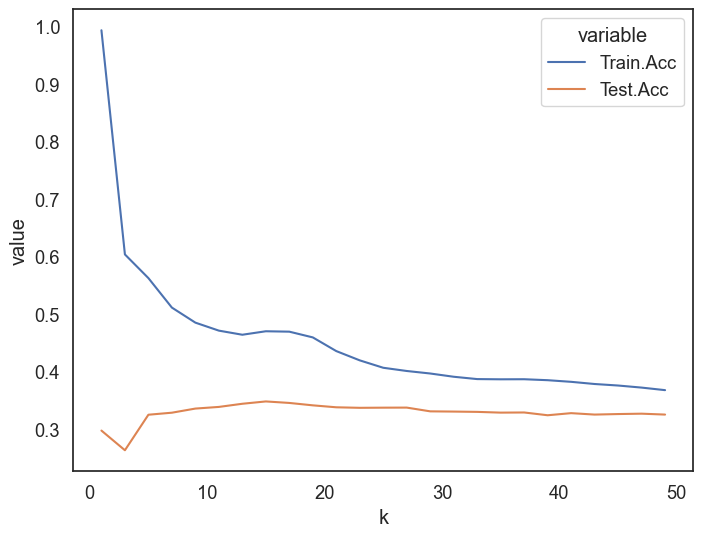

In [123]:
# helper for making a graph nicely
from pylab import rcParams
import seaborn as sns

sns.set(font_scale=1.2)
sns.set_style("white") #whitegrid white dark darkgrid

rcParams['figure.figsize'] = 8, 6
result = pd.DataFrame( {"k":ks,"Train.Acc":train_acc_list,"Test.Acc":test_acc_list} )
pd.melt(result, ['k'])
sns.lineplot(x="k",y="value", hue='variable', data=pd.melt(result, ['k']))

In [124]:
knn = knn_classifier(27)

In [125]:
knn_pca_accuracy_train = accuracy_on_train(knn, X_train, y_train)
knn_pca_accuracy_test = accuracy_on_test(knn, X_train, y_train, X_test, y_test)
print("KNN + PCA accuracy train", knn_pca_accuracy_train)
print("KNN + PCA accuracy test", knn_pca_accuracy_test)

KNN + PCA accuracy train 0.400977366255144
KNN + PCA accuracy test 0.3373368146214099
